# PRACTICA 1

Lluís Llull
Pablo Verde
---

Para realizar la práctica, se proponen una serie de ejercicios para obtener una buena
representación de la red y la información que contiene.

In [2]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import networkx as nx
import numpy as np
import pandas as pd
from pyvis.network import Network

colormap = plt.cm.tab20

def str_color(r,g,b,a):
    return "#" + format(int(r*255), f'0{2}x') + format(int(g*255), f'0{2}x') + format(int(b*255), f'0{2}x') + format(int(a*255), f'0{2}x')

def assign_colors(values):
    colors = [str_color(*colormap(v)) for v in values]
    return colors

def draw_communities(coms,G, ax=None):
    colors = assign_colors([coms[n] for n in G.nodes()])
    nx.draw(G, with_labels=True, ax=ax, node_color=colors)
    ax.set_title(f"Q:{nx.community.modularity(G, to_communities_list(coms)):.4f}")

def to_communities_list(coms):
    c_pos = {v:i for i,v in enumerate(set(coms.values()))}
    
    num_c = len(c_pos)
    com_list = [[] for _ in range(num_c)]
    for k,v in coms.items():
        com_list[c_pos[v]].append(k)

    return com_list

def to_communities_dict(coms):
    inv_map = {}
    for k, v in coms.items():
        inv_map[v] = inv_map.get(v, []) + [k]

    return inv_map

In [3]:

# Path to the GraphML file
file_path = "./hashtags_cleaned.graphml"

# Load the graph
G = nx.read_graphml(file_path)

# Explore the graph
print(f"Number of nodes: {G.number_of_nodes()}")
print(f"Number of edges: {G.number_of_edges()}")
print("Node attributes:", G.nodes(data=True))
print("Edge attributes:", G.edges(data=True))


Number of nodes: 47544
Number of edges: 536124
Node attributes: [('Υστερογραφα', {}), ('Chine', {}), ('OMS', {}), ('lockdown', {}), ('Beijing', {}), ('SmellDog', {}), ('Stimulus', {}), ('James', {}), ('WaterIsland', {}), ('Hoax', {}), ('FringeLeftists', {}), ('Epsteindidntkillhimself', {}), ('tgdn', {}), ('ocra', {}), ('AGBARRMUSTRESIGNNOW', {}), ('EURUSD', {}), ('NASDAQ', {}), ('Muslims', {}), ('Muslim', {}), ('MondayMorning', {}), ('nzpol', {}), ('TTIP', {}), ('wildlifephototgraphy', {}), ('birds', {}), ('birdphotography', {}), ('naturelovers', {}), ('forex', {}), ('forex_fx', {}), ('orbex_fx', {}), ('analiz', {}), ('piyasa', {}), ('ekonomi', {}), ('parite', {}), ('borsa', {}), ('abd', {}), ('usdjpy', {}), ('eurusd', {}), ('RememberinNovember', {}), ('ALLLIVESMATTER', {}), ('International', {}), ('FOX', {}), ('TeePublic', {}), ('thankyou', {}), ('ellenhenryart', {}), ('digitalart', {}), ('UniteBlue', {}), ('thelincolnproject', {}), ('Pakistan', {}), ('Britain', {}), ('DemocratsAgains

In [4]:
# plt.figure(figsize=(10, 10))
# pos = nx.spring_layout(G)  # Compute layout for visualization
# nx.draw(
#     G, 
#     pos, 
#     with_labels=True, 
#     node_size=500, 
#     node_color="lightblue", 
#     edge_color="gray", 
#     font_size=10
# )

# # Show the plot
# plt.title("Graph Visualization")
# plt.show()

1. Calcula las comunidades, utilizándoselo el algoritmo de Leiden. ¿Cuantas comunidades
salen?

In [5]:
from cdlib.algorithms import leiden

# Configurar el grafo G (asegúrate de que sea un grafo de NetworkX)
nx.set_edge_attributes(G, 1, "weight")

# Aplicar el algoritmo de Leiden
leiden_result = leiden(G)

# Obtener el mapeo de nodos a comunidades
leiden_coms = leiden_result.to_node_community_map()
print(leiden_coms)

# Transformar el mapeo si solo necesitas una comunidad por nodo
coms = {k: v[0] for k, v in leiden_coms.items()}

# Dibujo (si tienes una función personalizada para dibujar las comunidades)
# draw_communities(coms, G, ax)

# Ejemplo básico de dibujo de grafos
# _, ax = plt.subplots(1, figsize=(6, 6))
# pos = nx.spring_layout(G)
# nx.draw(G, pos, ax=ax, node_color=[coms[node] for node in G.nodes()], with_labels=True)
# plt.show()


Note: to be able to use all crisp methods, you need to install some additional packages:  {'infomap', 'wurlitzer', 'graph_tool', 'bayanpy'}
Note: to be able to use all crisp methods, you need to install some additional packages:  {'ASLPAw', 'pyclustering'}
Note: to be able to use all crisp methods, you need to install some additional packages:  {'infomap', 'wurlitzer'}
defaultdict(<class 'list'>, {'Chine': [0], 'OMS': [0], 'Beijing': [0], 'SmellDog': [0], 'James': [0], 'WaterIsland': [0], 'TTIP': [0], 'International': [0], 'Pakistan': [0], 'Britain': [0], 'Noticias': [0], 'Cardinals': [0], 'Wildcats': [0], 'GhislaineMaxwell': [0], 'StarTribune': [0], 'Vikings': [0], 'GeorgesFloyd': [0], 'Sports': [0], 'JohnLewis': [0], 'Wildfires': [0], 'BostonGlobe': [0], 'Celtics': [0], 'RedSox': [0], 'LATimes': [0], 'LosAngeles': [0], 'LAPD': [0], 'Lakers': [0], 'Rams': [0], 'Angels': [0], 'Clippers': [0], 'Cougars': [0], 'Rockets': [0], 'Astros': [0], 'Abbott': [0], 'Bulls': [0], 'Cubs': [0], 'Bear

In [6]:
num_coms = len(set(coms.values()))
print(f"Number of communities: {num_coms}")

Number of communities: 65


2. El tamaño del grafo excede el tiempo que tenemos en la prác>ca, por ello, y para tener
una representación más compacta, colapsa el grafo de forma que cada nodo sea una
comunidad, manteniéndoosla los atributos.

In [7]:
from collections import defaultdict

attr = "weight"
collapsed_graph = nx.Graph()

    # Reverse the community map: community -> nodes
community_to_nodes = defaultdict(list)
for node, community in coms.items():
    community_to_nodes[community].append(node)

# Add supernodes (one for each community)
for community in community_to_nodes:
    collapsed_graph.add_node(community, nodes=community_to_nodes[community])

# Aggregate edges between communities
for u, v, data in G.edges(data=True):
    com_u = coms[u]
    com_v = coms[v]

    if com_u != com_v:  # Inter-community edge
        if collapsed_graph.has_edge(com_u, com_v):
            collapsed_graph[com_u][com_v][attr] += data.get(attr, 1)
        else:
            collapsed_graph.add_edge(com_u, com_v, **{attr: data.get(attr, 1)})

for node in collapsed_graph.nodes(data = True):
    node[1]['num_nodes'] = len(node[1]['nodes'])

In [8]:
# max_weight = max([collapsed_graph.edges[e]["weight"] for e in collapsed_graph.edges])
# min_weight = min([collapsed_graph.edges[e]["weight"] for e in collapsed_graph.edges])
# for e in collapsed_graph.edges:
#     collapsed_graph.edges[e]["weight"] = max((collapsed_graph.edges[e]["weight"]-min_weight) / (max_weight - min_weight), 0.1)


In [9]:
edge_weights = nx.get_edge_attributes(collapsed_graph, "weight")
weights = np.array(list(edge_weights.values()))
min_weight = np.min(weights)
max_weight = np.max(weights)

# Apply logarithmic scaling for better contrast
scaled_weights = np.log1p(weights - min_weight + 1)  # log(1 + weight) to avoid log(0)
min_scaled = np.min(scaled_weights)
max_scaled = np.max(scaled_weights)
norm = mcolors.Normalize(vmin=min_scaled, vmax=max_scaled, clip=True)

# Create grayscale colors (0=black, 1=white)
edge_colors = [plt.cm.Greys(norm(np.log1p(edge_weights[edge] - min_weight + 3))) for edge in collapsed_graph.edges]

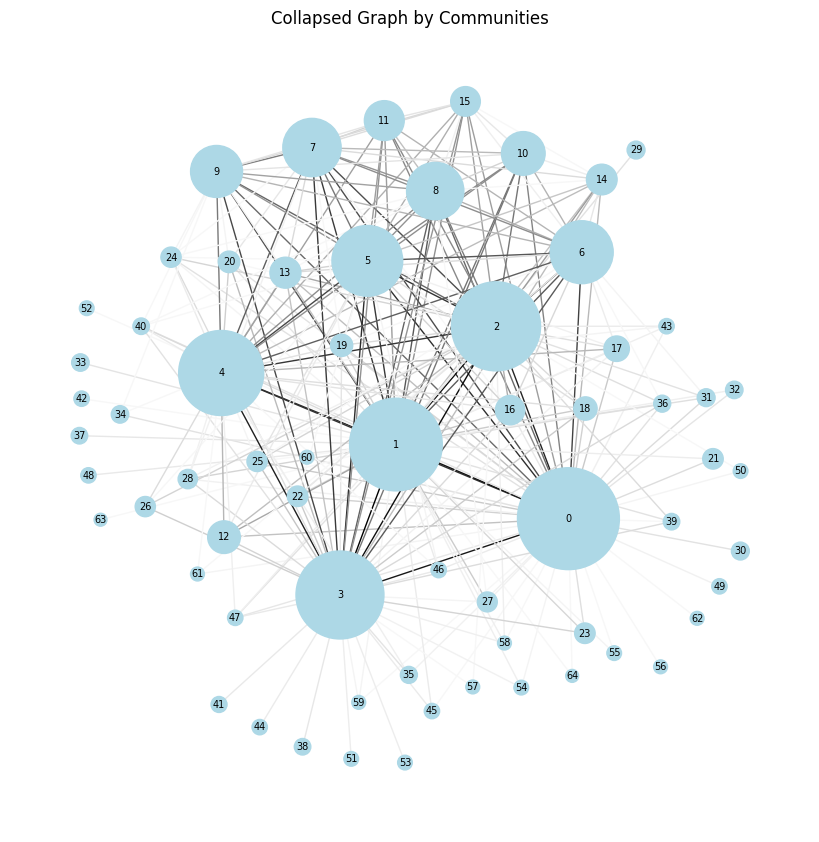

In [10]:
    # Plot the collapsed graph
plt.figure(figsize=(8, 8))
pos = nx.forceatlas2_layout(collapsed_graph, strong_gravity=True,dissuade_hubs=False)
nx.draw(
    collapsed_graph,
    pos,
    with_labels=True,
    node_size= [50*np.sqrt(collapsed_graph.nodes[node]['num_nodes']) for node in collapsed_graph.nodes],
    node_color="lightblue",
    edge_color=edge_colors  ,
    font_size=7,
    # edge_cmap=plt.cm.Greys,
)
plt.title("Collapsed Graph by Communities")
plt.show()

3. Aplica distintas métricas que puedan resultar útiles para tener una mejor idea de las
comunidades, y crea visualizaciones diferentes en función de las métricas.


4. ¿Hay nodos centrales?, ¿qué métricas nos ayudan a saberlo? ¿Qué métricas macro nos
servirían para explicar la estructura de la red, teniendo en cuenta que son
comunidades y no nodos?

In [8]:
import networkx as nx

def calculate_network_metrics(G):
    # 1. Grado (Degree)
    degree_centrality = dict(G.degree())
    
    # 2. Betweeness Centrality
    betweenness_centrality = nx.betweenness_centrality(G)
    
    # 3. Closeness Centrality
    closeness_centrality = nx.closeness_centrality(G)
    
    # 4. Eigenvector Centrality
    eigenvector_centrality = nx.eigenvector_centrality(G, max_iter=1000)
    
    # 5. PageRank
    pagerank = nx.pagerank(G)
    
    # 6. Modularidad (Modularity)
    # Necesitas una partición de la red para calcular la modularidad. Usamos la comunidad de Louvain.
    communities = list(nx.community.greedy_modularity_communities(G))
    modularity = nx.community.modularity(G, communities)
    
    # 7. Coeficiente de agrupamiento (Clustering Coefficient)
    clustering_coefficient = nx.clustering(G)
    
    # 8. Diámetro de la red
    # Calculamos el diámetro de la red (si es conexa). Si la red no es conexa, no podemos calcular el diámetro.
    if nx.is_connected(G):
        diameter = nx.diameter(G)
    else:
        diameter = "La red no es conexa, no se puede calcular el diámetro."
    
    # 9. Promedio de la longitud de los caminos (Average Path Length)
    if nx.is_connected(G):
        avg_path_length = nx.average_shortest_path_length(G)
    else:
        avg_path_length = "La red no es conexa, no se puede calcular el camino promedio."
    
    # Resultados
    return {
        "Grado (Degree)": degree_centrality,
        "Betweeness Centrality": betweenness_centrality,
        "Closeness Centrality": closeness_centrality,
        "Eigenvector Centrality": eigenvector_centrality,
        "PageRank": pagerank,
        "Modularidad": modularity,
        "Clustering Coefficient": clustering_coefficient,
        "Diámetro de la Red": diameter,
        "Average Path Length": avg_path_length
    }

metrics = calculate_network_metrics(collapsed_graph)

# Imprimir resultados
for metric, value in metrics.items():
    if isinstance(value,dict):
        top_5 = dict(sorted(value.items(), key=lambda item: item[1], reverse=True)[:3])
        print(f"{metric}:")
        for node, score in top_5.items():
            print(f"  {node}: {score}")
    else:
        print(f"{metric}:\n{value}\n")


Grado (Degree):
  2: 31
  3: 30
  5: 30
Betweeness Centrality:
  2: 0.22031209531209534
  3: 0.1959306288253657
  5: 0.14959684564947723
Closeness Centrality:
  2: 0.8297872340425532
  3: 0.8125
  5: 0.8125
Eigenvector Centrality:
  2: 0.28134601205852955
  0: 0.27782294280790953
  5: 0.27758547032455105
PageRank:
  5: 0.18861532519450064
  2: 0.15965941058774138
  1: 0.13806132036532393
Modularidad:
-0.10996706645219155

Clustering Coefficient:
  11: 1.0
  14: 1.0
  15: 1.0
Diámetro de la Red:
3

Average Path Length:
1.7871794871794873



5. ¿Merece la pena hacer comunidades solapadas o no solapadas?

    

In [9]:
G.nodes()

NodeView(('Υστερογραφα', 'Chine', 'OMS', 'lockdown', 'Beijing', 'SmellDog', 'Stimulus', 'James', 'WaterIsland', 'Hoax', 'FringeLeftists', 'Epsteindidntkillhimself', 'tgdn', 'ocra', 'AGBARRMUSTRESIGNNOW', 'EURUSD', 'NASDAQ', 'Muslims', 'Muslim', 'MondayMorning', 'nzpol', 'TTIP', 'wildlifephototgraphy', 'birds', 'birdphotography', 'naturelovers', 'forex', 'forex_fx', 'orbex_fx', 'analiz', 'piyasa', 'ekonomi', 'parite', 'borsa', 'abd', 'usdjpy', 'eurusd', 'RememberinNovember', 'ALLLIVESMATTER', 'International', 'FOX', 'TeePublic', 'thankyou', 'ellenhenryart', 'digitalart', 'UniteBlue', 'thelincolnproject', 'Pakistan', 'Britain', 'DemocratsAgainstTrump', 'CoronaVirusUSA', 'Covid19USA', 'VoteJoe2020', 'presidenttrump', 'Terrorists', 'rigged', 'FridayVibes', 'MJforTexas', 'MakeItCount', 'LoveIsLove', 'LoveWins', 'Jinek', 'nosjournaal', 'InsultANazi', 'resign', 'FRAUD', '2020Elections', 'ForeignThreats', 'CyberThreats', 'DXY', 'FederalReserve', 'Friday', 'Noticias', 'FacebookLive', 'apparel',

- Comunidades no solapadas
    Estas asumen que cada nodo (hashtag) pertenece exclusivamente a una comunidad. Esto es adecuado cuando:

    - Los temas son claramente diferenciables y los hashtags están claramente asignados a un único tema.
    - Quieres resumir la red de manera más simple y enfocarte en relaciones disjuntas.
    Sin embargo, en una red como esta, donde hashtags pueden participar en múltiples conversaciones, las comunidades no solapadas pueden simplificar demasiado la estructura real y perder conexiones importantes.

- Comunidades solapadas
    Estas permiten que un nodo pertenezca a múltiples comunidades, lo cual es útil en tu caso porque:

    - Hashtags están frecuentemente relacionados con varios temas
    - Permiten identificar temas transversales o nodos puente, es decir, hashtags que conectan varias comunidades temáticas.
    - Reflejan la naturaleza dinámica y multifacética de las conversaciones en redes sociales, donde los límites entre temas no son estrictos.
- Conclusión
    En este contexto, a priori podriamos pensar que se puede utilizar  comunidades no solapadas ya que el tema está acotado a las elecciones (es decir, en caso de que fueran hastangs más genéricos y no solo elecciones no habría duda que es mejor usar un gráfico solapado) aun así, seguimos pensando que es más adecuado trabajar con comunidades solapadas, porque:

    - Los hashtags suelen participar en múltiples conversaciones o temas.
    - Los datos de redes sociales tienen una naturaleza compleja y entrelazada.

De todas formas, vemos que la densidad del grafo es muy baja 0.0005, esto significa que es complicado que exista un solapamineto claro, aun así vamos a probar algun algoritmo de generación de ciomunidades solapadas para comprobar las diferencias con Louvain hecho anteriormente.

In [11]:
density = nx.density(G)
print(f"Densidad del grafo: {density:.4f}")


Densidad del grafo: 0.0005


Comunidades detectadas por Label Propagation:
Comunidad 1: [0, 1, 2, 3, 4, 5, 6, 7, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 32, 33, 34, 36, 37, 38, 39, 40, 41, 42, 43, 44, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 75, 76, 77, 78, 80, 83, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98]
Comunidad 2: [8, 35, 45]
Comunidad 3: [31]
Comunidad 4: [57, 79, 81, 82]
Comunidad 5: [70, 84]
Comunidad 6: [99]


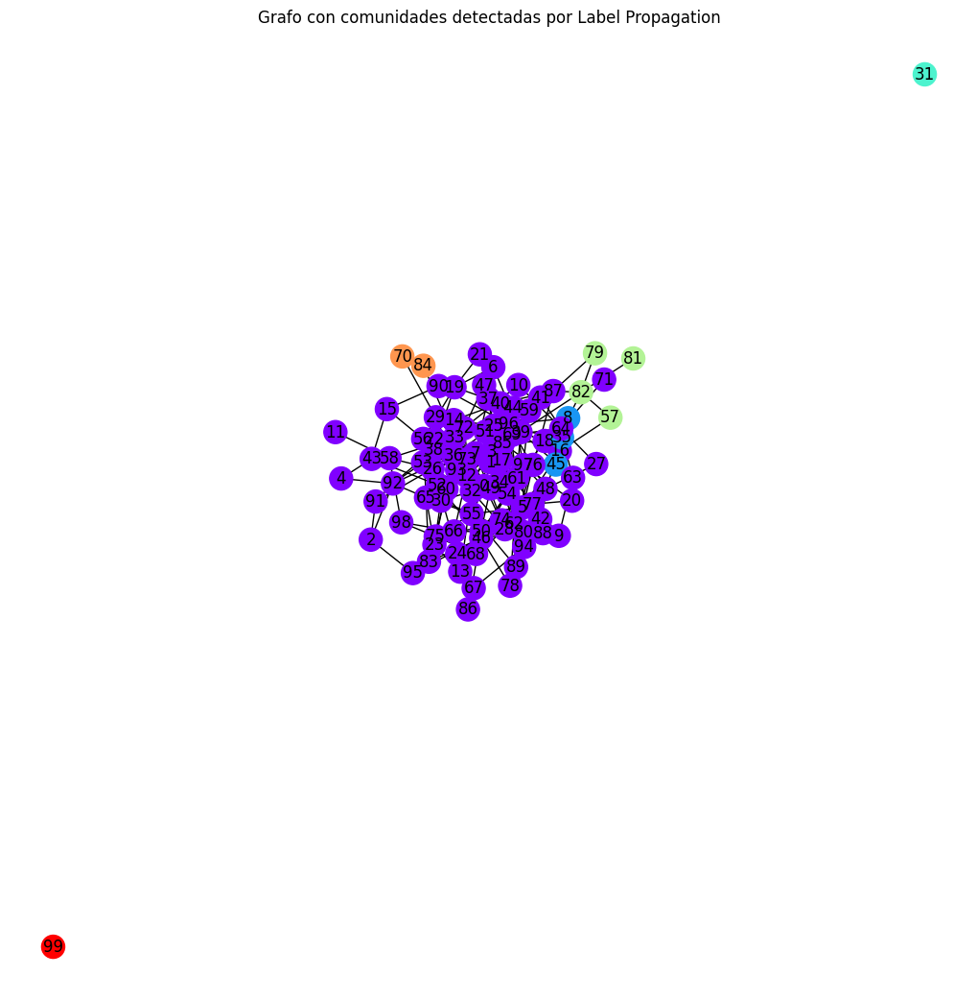

In [140]:
communities = nx.algorithms.community.label_propagation.label_propagation_communities(G)

# Convertir las comunidades en un formato más manejable (una lista de nodos por comunidad)
community_list = list(communities)

# Imprimir las comunidades detectadas
print("Comunidades detectadas por Label Propagation:")
for idx, community in enumerate(community_list):
    print(f"Comunidad {idx + 1}: {sorted(community)}")

# Crear un diccionario de colores para los nodos, basado en las comunidades
node_colors = {}
for idx, community in enumerate(community_list):
    for node in community:
        node_colors[node] = idx

# Visualizar el grafo con colores según las comunidades detectadas
pos = nx.spring_layout(G)  # Usamos el layout spring para la visualización
colors = [node_colors[node] for node in G.nodes()]

plt.figure(figsize=(10, 10))
nx.draw(G, pos, node_color=colors, with_labels=True, cmap=plt.cm.rainbow, node_size=300)
plt.title("Grafo con comunidades detectadas por Label Propagation")
plt.show()

In [42]:
from cdlib.algorithms import cpm
import networkx as nx
import matplotlib.pyplot as plt

# Configurar el grafo G
nx.set_edge_attributes(G, 1, "weight")  # Si no tienes pesos, puedes omitir esta línea

# Aplicar CPM con un valor de resolución (ajustar granularidad de las comunidades)
resolution_parameter = 0.05  # Ajusta según la densidad esperada
cpm_result = cpm(G, resolution_parameter=resolution_parameter)

# Obtener el mapeo de nodos a comunidades
cpm_coms = cpm_result.to_node_community_map()
print("Comunidades detectadas (nodo -> comunidades):")
print(cpm_coms)


Comunidades detectadas (nodo -> comunidades):
defaultdict(<class 'list'>, {'lockdown': [0], 'Stimulus': [0], 'MondayMorning': [0], 'UniteBlue': [0], 'presidenttrump': [0], 'Terrorists': [0], 'rigged': [0], 'FridayVibes': [0], '2020Elections': [0], 'LosAngeles': [0], 'Traitor': [0], 'hope': [0], 'Loser': [0], 'tiktok': [0], 'Impeachment': [0], 'peace': [0], 'Elecciones': [0], 'kamala': [0], 'nevada': [0], 'history': [0], 'ProudBoys': [0], 'Section230': [0], 'Polls': [0], 'bernie': [0], 'wakeup': [0], 'Inauguration': [0], 'TedCruz': [0], 'cartoon': [0], 'Fraud': [0], 'McConnell': [0], 'bhfyp': [0], 'LadyGaga': [0], 'LoserInChief': [0], 'trumprally': [0], 'FactCheck': [0], 'NEWS': [0], 'SenateGOP': [0], 'prochoice': [0], 'propaganda': [0], 'unitedstates': [0], 'FillTheSeat': [0], 'win': [0], 'Australia': [0], 'Faith': [0], 'TrumpOut': [0], 'msm': [0], 'share': [0], 'SaturdayVibes': [0], 'POTUS46': [0], 'proudboys': [0], 'prolife': [0], 'pennsylvania': [0], 'COVIDIOT': [0], 'RiggedElection

Vemos que con *CMP* no aparece solapamineto en las comunidades.

In [43]:
# Estadísticas clave
num_communities = len(cpm_result.communities)
num_nodes = G.number_of_nodes()
avg_communities_per_node = sum(len(communities) for communities in cpm_coms.values()) / num_nodes
max_communities_per_node = max(len(communities) for communities in cpm_coms.values())
min_communities_per_node = min(len(communities) for communities in cpm_coms.values())

# Impresión de estadísticas
print(f"Total de comunidades detectadas: {num_communities}")
print(f"Número total de nodos: {num_nodes}")
print(f"Promedio de comunidades por nodo: {avg_communities_per_node:.2f}")
print(f"Máximo de comunidades a las que pertenece un nodo: {max_communities_per_node}")
print(f"Mínimo de comunidades a las que pertenece un nodo: {min_communities_per_node}")

# Imprimir algunas comunidades para explorar
print("\nEjemplo de comunidades detectadas:")
for i, community in enumerate(cpm_result.communities[:5]):  # Mostrar solo las primeras 5 comunidades
    print(f"Comunidad {i+1}: {sorted(community)}")

Total de comunidades detectadas: 21272
Número total de nodos: 47544
Promedio de comunidades por nodo: 1.00
Máximo de comunidades a las que pertenece un nodo: 1
Mínimo de comunidades a las que pertenece un nodo: 1

Ejemplo de comunidades detectadas:
Comunidad 1: ['1776Again', '1A', '200KDeadAmericans', '2020Election', '2020Elections', '2020PresidentialElection', '2020debate', '2020election', '25AmendmentNow', '25thAmendment', '2A', '2a', '2ndAmendment', '46thPresident', '4MoreYears', '4moreyears', '60Minutes', 'ABC', 'ABCNews', 'ACA', 'ACB', 'AMAs', 'AMERICA', 'AMERICAISBACK', 'ANTIFA', 'AOC', 'AZ', 'Alabama', 'Alaska', 'AllLivesMatter', 'Amazon', 'America', 'AmericaDecides', 'AmericaDecides2020', 'AmericaFirst', 'AmericaOrTrump', 'American', 'Americans', 'AmericasGreatestMistake', 'AmyComeyBarrett', 'Antifa', 'AntifaTerrorists', 'Apple', 'Arizona', 'Arkansas', 'ArmyForTrump', 'ArrestTrump', 'ArrestTrumpNow', 'Atlanta', 'AuditTheVote', 'Australia', 'BBC', 'BIDEN', 'BIDEN2020', 'BLEXIT',

6. ¿Si visualizamos la/s comunidad/es más grandes y las más pequeñas que se ve, que
nos dice esa representación?

In [157]:
collapsed_graph.nodes(data=True)

NodeDataView({0: {'nodes': ['nzpol', 'TTIP', 'abd', 'Pakistan', 'ForeignThreats', 'CyberThreats', 'Noticias', 'recall', 'USDebt', 'TRENDING', 'Uruguay', 'Hurts', 'Bolivia', 'Chile', 'Idiot', 'Mundo', 'ElNacionalRD', 'LAWandORDER', 'BibleBeliever', 'r4today', 'Ginsburg', 'giudice', 'CorteSuprema', 'Californie', 'Court', 'StatiUniti', 'CasaBianca', 'cdanslair', 'CaboVerde', 'CourSuprême', 'homelessness', 'Transgender', 'majorité', 'Garcetti', 'LadyGraham', 'caezaepichi', 'Lega', 'Fdi', 'nzqanda', 'PaulRyan', 'RadicalRight', 'Freemasonry', 'säkpol', 'dkpol', 'turpo', 'CLTV', 'Amlo', 'FCC', 'SiliconValley', 'TulsiGabbard', 'Prosecutor', 'legal', 'Murkowski', 'qanda', 'américaine', 'CoVid19', 'ridiculous', 'Suriname', 'Guyana', 'Brasil', 'TellTheTruth', 'Tax', 'DDHH', 'DZT', 'service', 'Tiredearth', 'GMB', 'Ecuador', 'WARNING', 'sarcasm', 'families', 'pd', 'MORNINGJOE', 'irony', 'LCI', 'La26', 'populism', 'LebronJames', 'golfing', 'IranRegime', 'nurse', 'Healing', 'TechNews', 'lying', 'Ukra

In [162]:
max_weight = max([collapsed_graph.nodes[n]["num_nodes"] for n in collapsed_graph.nodes])
min_weight = min([collapsed_graph.nodes[n]["num_nodes"] for n in collapsed_graph.nodes])

for n in collapsed_graph.nodes:
    if collapsed_graph.nodes[n]["num_nodes"] == max_weight:
        max_node = n
    if collapsed_graph.nodes[n]["num_nodes"] == min_weight:
        min_node = n

In [166]:
collapsed_graph.nodes[max_node]['nodes']

['nzpol',
 'TTIP',
 'abd',
 'Pakistan',
 'ForeignThreats',
 'CyberThreats',
 'Noticias',
 'recall',
 'USDebt',
 'TRENDING',
 'Uruguay',
 'Hurts',
 'Bolivia',
 'Chile',
 'Idiot',
 'Mundo',
 'ElNacionalRD',
 'LAWandORDER',
 'BibleBeliever',
 'r4today',
 'Ginsburg',
 'giudice',
 'CorteSuprema',
 'Californie',
 'Court',
 'StatiUniti',
 'CasaBianca',
 'cdanslair',
 'CaboVerde',
 'CourSuprême',
 'homelessness',
 'Transgender',
 'majorité',
 'Garcetti',
 'LadyGraham',
 'caezaepichi',
 'Lega',
 'Fdi',
 'nzqanda',
 'PaulRyan',
 'RadicalRight',
 'Freemasonry',
 'säkpol',
 'dkpol',
 'turpo',
 'CLTV',
 'Amlo',
 'FCC',
 'SiliconValley',
 'TulsiGabbard',
 'Prosecutor',
 'legal',
 'Murkowski',
 'qanda',
 'américaine',
 'CoVid19',
 'ridiculous',
 'Suriname',
 'Guyana',
 'Brasil',
 'TellTheTruth',
 'Tax',
 'DDHH',
 'DZT',
 'service',
 'Tiredearth',
 'GMB',
 'Ecuador',
 'WARNING',
 'sarcasm',
 'families',
 'pd',
 'MORNINGJOE',
 'irony',
 'LCI',
 'La26',
 'populism',
 'LebronJames',
 'golfing',
 'IranReg

In [167]:
collapsed_graph.nodes[min_node]['nodes']

['شب_بخیر_ایران', 'فرح', 'انقلاب۵۷']

7. Finalmente, describe los contenidos de cada comunidad. ¿Es posible, aunque sea
intui>vamente, caracterizar una comunidad en función de sus hashtags más
importantes?

In [12]:
len(collapsed_graph.nodes())

65

In [15]:
for i in range(1, len(collapsed_graph.nodes())-2):
    print('Hastags comunidad', i)
    print(collapsed_graph.nodes[i]['nodes'])
    print('-'*50)


Hastags comunidad 1
['Stimulus', 'FringeLeftists', 'Epsteindidntkillhimself', 'tgdn', 'ocra', 'Muslims', 'RememberinNovember', 'ALLLIVESMATTER', 'FOX', 'FOURMOREYEARS', 'C19', 'BidenIsALoser', 'McSally', 'PATRIOT', 'JamesMurdoch', 'FoxNetwork', 'BidenVoters', 'NeverGiveUp', 'Benghazi4', 'Kavanaugh', 'cufflinks', 'collectible', 'collectibles', 'Mensfashion', 'USNavy', 'Protestants', 'Evangelists', 'USAirForce', 'Baptists', 'Mormons', 'College', 'EsquerdaLixo', 'BidenIsALiar', 'Earth', 'MASA', 'Fakenews', 'mediabias', 'restartleader', 'NoHR1044', 'NoHR8089', 'Navy', 'ProudBoys', 'Section230', 'AlJazeera', 'NewsMax', 'Rednecks', 'CNNisFakeNews', 'Catholics', 'Teaparty', 'RogerStone', 'CCPChina', 'Oligarchs', 'RushLimbaugh', 'R', 'Republic', 'GenX', 'Boomers', 'FirstStepAct', 'Wexit', 'TRUMPTRAIN2020', 'K9', '2020Vote', 'BidensRiots', 'TrumpSupporter', 'MAGA2028', 'MAGA2032', 'MAGA2040', 'BeBrave', 'Gospel', 'Fraud', 'BidenSewer', 'Swamp', 'RiotFuelMSM', 'IPO', 'PrayForAmerica', 'CandaceOw

Efectivamente es posible caracterizar y difernciar las comunidades en función de las hastags que las conforman. Por ejemplo se ve muy claramente en loos dos siguietnes ejemplos:

In [18]:
print(f'Comunidad 6. Comunidad relacionada con la inversión y la bolsa')
print(collapsed_graph.nodes[6]['nodes'])

print(f'Comunidad 48. Comunidad de caracteres Japoneses')
print(collapsed_graph.nodes[48]['nodes'])

print(f'Comunidad 46. Comunidad relacionada con aspectos éticos')
print(collapsed_graph.nodes[46]['nodes'])

print(f'Comunidad 10. Comunidad relacionada con pajaros, aves, naturaleza y otros elementos voladores')
print(collapsed_graph.nodes[10]['nodes'])

Comunidad 6. Comunidad relacionada con la inversión y la bolsa
['EURUSD', 'NASDAQ', 'forex', 'forex_fx', 'orbex_fx', 'analiz', 'piyasa', 'ekonomi', 'parite', 'borsa', 'abd', 'usdjpy', 'eurusd', 'DXY', 'FederalReserve', 'farmers', 'Border', 'wealth', 'GOLD', 'wechat', 'pazar', 'trade', 'LeBron', 'agriculture', 'BackToSchool', 'ESG', 'Csr', 'Sri', 'growth', 'dollar', 'recession', 'recovery', 'WhatsApp', 'stockstowatch', 'finance', 'redsox', 'Travel', 'BusinessTravel', 'Markets', 'domainnames', 'Logo', 'unique', 'logodesign', 'womenwhoCode', 'graphicdesigner', '100DaysOfCode', 'Fiverr', 'training', 'money', 'DOW', 'long', 'BigData', 'DJIA', 'Bangladesh', 'barrons', 'jlo', 'gold', 'silver', 'bonds', 'FiverrBox', 'FiverrGig', 'bigdata', 'IoT', 'Tech', 'Linux', 'dataScientist', 'dataScience', 'WomenWhoCode', 'Rstats', 'FemTech', '49ers', 'stock', 'invest', 'wallstreet', 'treasury', 'Innovation', 'happinesstoy', 'lifecoaching', 'Singularity', 'Analytics', 'DataScience', 'IIoT', 'PyTorch', 'Py

Aun así, también se observa que hay comunidades que no tienen una clara temática en común, como los siguietnes ejemplos:

In [ ]:
print(f'Comunidad 1 y 4. Comunidades relacionadas con temas diversos y sin una temática clara')
print(collapsed_graph.nodes[1]['nodes'])

print(collapsed_graph.nodes[4]['nodes'])


Comunidad 6. Comunidad relacionada con la inversión y la bolsa
['EURUSD', 'NASDAQ', 'forex', 'forex_fx', 'orbex_fx', 'analiz', 'piyasa', 'ekonomi', 'parite', 'borsa', 'abd', 'usdjpy', 'eurusd', 'DXY', 'FederalReserve', 'farmers', 'Border', 'wealth', 'GOLD', 'wechat', 'pazar', 'trade', 'LeBron', 'agriculture', 'BackToSchool', 'ESG', 'Csr', 'Sri', 'growth', 'dollar', 'recession', 'recovery', 'WhatsApp', 'stockstowatch', 'finance', 'redsox', 'Travel', 'BusinessTravel', 'Markets', 'domainnames', 'Logo', 'unique', 'logodesign', 'womenwhoCode', 'graphicdesigner', '100DaysOfCode', 'Fiverr', 'training', 'money', 'DOW', 'long', 'BigData', 'DJIA', 'Bangladesh', 'barrons', 'jlo', 'gold', 'silver', 'bonds', 'FiverrBox', 'FiverrGig', 'bigdata', 'IoT', 'Tech', 'Linux', 'dataScientist', 'dataScience', 'WomenWhoCode', 'Rstats', 'FemTech', '49ers', 'stock', 'invest', 'wallstreet', 'treasury', 'Innovation', 'happinesstoy', 'lifecoaching', 'Singularity', 'Analytics', 'DataScience', 'IIoT', 'PyTorch', 'Py

Vemos que por norma general como mayor número de hashtags tenga una comunidad, más diversa es la temática que la caracteriza. Por otro lado, las comunidades con menos hashtags tienden a ser más claras y concisas.